In [1]:
import pandas as pd
import altair as alt

In [2]:
pd.set_option('display.max_columns', 112)
alt.renderers.enable('notebook')

In [3]:
az_complaints = pd.read_csv('../data/whd_whisard.csv', dtype=({'naic_cd': str}))

In [4]:
top_complaints = az_complaints[az_complaints['case_violtn_cnt'] >= 150000]


# Nationwide Wage Complaints

## Top 5

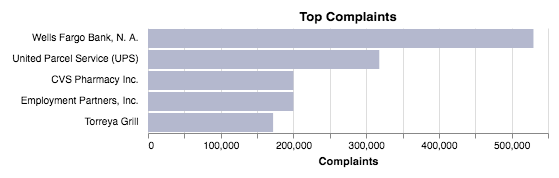

In [5]:
alt.Chart(
    top_complaints, 
    padding = 10, 
    title = 'Top Complaints'
).mark_bar(
    color = '#b4b8ce'
).encode(
    x = alt.X(
        'case_violtn_cnt',
        axis = alt.Axis(title = "Complaints")
    ), 
    y = alt.Y(
        'trade_nm', 
        sort = alt.SortField(
            field = 'case_violtn_cnt', 
            op = 'sum', 
            order = 'descending'), 
        axis = alt.Axis(ticks = False, labelPadding = 10, title = None, domain = False))).configure_view(stroke = 'transparent')

In [9]:
top_complaints[['trade_nm', 'bw_atp_amt']]

,trade_nm,bw_atp_amt
33245,"Employment Partners, Inc.",0.00
119367,"Wells Fargo Bank, N. A.",0.00
131591,United Parcel Service (UPS),0.00
163213,CVS Pharmacy Inc.,0.00
231738,Torreya Grill,269.76


In [13]:
payments = az_complaints.sort_values(by=['bw_atp_amt'], ascending=False)
payments['pay_per_case'] = (payments['bw_atp_amt']/payments['case_violtn_cnt'])
payments = payments.sort_values(by=['pay_per_case'], ascending=False)
payments.head()[['trade_nm', 'case_violtn_cnt', 'pay_per_case', 'bw_atp_amt', 'findings_start_date', 'findings_end_date']]

,trade_nm,case_violtn_cnt,pay_per_case,bw_atp_amt,findings_start_date,findings_end_date
249894,Great River Medical Center,1,344615.480000,344615.48,2014-12-01,2015-10-09
3735,"Knight Protective Service, Inc.",3,223569.393333,670708.18,2006-04-15,2006-09-15
92256,Joseph & Ghenet Mesfun,1,161367.000000,161367.00,1992-09-01,2003-06-30
626,IT Resources Inc.,1,157677.200000,157677.20,2008-10-01,2011-09-26
227965,Community Health Clinic,1,141881.510000,141881.51,2001-05-01,2003-11-29


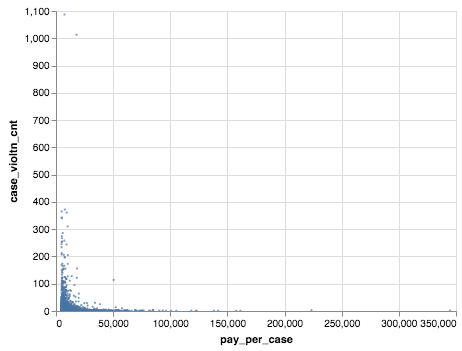

In [14]:
alt.Chart(payments.head(5000)).mark_circle(size = 5).encode(x = 'pay_per_case', y = 'case_violtn_cnt')

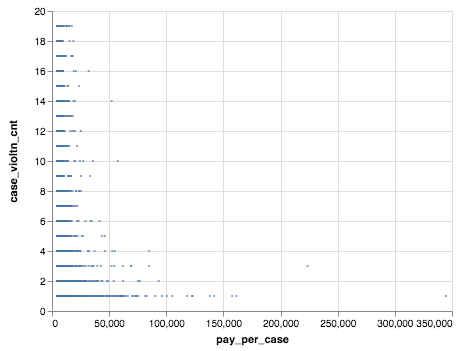

In [15]:
fu = payments
bar = fu[(fu['case_violtn_cnt'] < 20) & (fu['case_violtn_cnt'] > 0)]
bar = bar.head(5000)
alt.Chart(bar).mark_circle(size = 5).encode(x = 'pay_per_case', y = 'case_violtn_cnt')


# Nationwide vs Arizona Wage Complaints

Here we go in and do stuff

In [17]:
government_payments = payments[(payments['naics_code_description'] == 'Other Local Governmental Facilities')]
az_government_payments = government_payments[government_payments['st_cd'] == 'AZ']

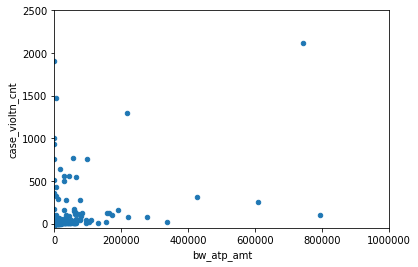

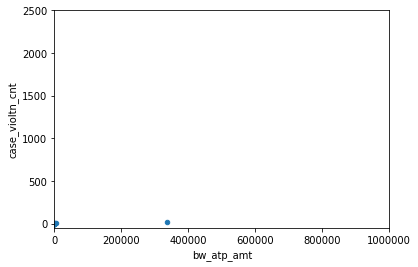

In [20]:
government_payments.plot(kind='scatter', x='bw_atp_amt', y='case_violtn_cnt', alpha=1, ylim = (-50, 2500), xlim = (-50, 1000000))
az_government_payments.plot(kind='scatter', x='bw_atp_amt', y='case_violtn_cnt', alpha=1, ylim = (-50, 2500), xlim = (-50, 1000000))


In [28]:
az_government_payments = az_government_payments.fillna(0)
az_government_payments[['trade_nm', 'case_violtn_cnt', 'pay_per_case', 'bw_atp_amt', 'findings_start_date', 'findings_end_date']]

,trade_nm,case_violtn_cnt,pay_per_case,bw_atp_amt,findings_start_date,findings_end_date
215282,Pima County/Development Services,18,18736.188333,337251.39,2007-03-05,2009-03-14
223556,City of Nogales,2,1744.355000,3488.71,2002-11-01,2004-11-01
219824,Maricopa County Adult Probation,3,1099.240000,3297.72,2007-05-29,2009-05-28
234131,Pima County Animal Care Center,5,26.206000,131.03,2013-03-03,2016-02-27
70271,Arizona Dept. of Economic Security,1,0.000000,0.00,2014-12-09,2016-12-08
16116,Maricopa County Adult Probation,1,0.000000,0.00,2006-09-07,2007-02-05
29743,Sheraton Hotel Phoenix Downtown,0,0.000000,0.00,2010-04-10,2012-04-09
14602,City of Phoenix Aviation,0,0.000000,0.00,2004-12-01,2006-11-30
14515,City of Surprise,0,0.000000,0.00,2004-09-01,2006-08-31
17412,Maricopa County Adult Probation,0,0.000000,0.00,2006-11-15,2007-02-08


# Results
Arizona has 14 cases in the database. Of those, 4 resulted in back wages paid. Pima county was 2 of those 4.